### Project Overview 

<p>Turnover is the number of employees that leave, voluntarily or involuntarily, an organization in a period of time. In either way, companies have to replace those employees to keep the optimal operation of their activities. The extent to which employers face turnover rates and the cost often varies by organizations and industries. Depending on the industry, management has to pay particular attention to the turnover rate since it can reduce the productivity and loss of clients that affect the company's long-run bottom line. In this project, we will try to uncover the key variables that contribute to employee turnover.  </p>

#### Problem Statement 

<p> As we stated in the problem overview, employee turnover is costly for companies in the sense that it could affect the bottom line of the organization in the long run. Understanding the drivers of the phenomenon could help managers be proactive, keep their high performer employees, and maintain the company's sustainable development. In this HR predictive analysis, we will use a machine learning model to uncover the key indicators that lead an employee to leave the company. knowing in advance those indicators help management to implement a comprehensive employee engagement and inclusion program.</p >

####  Import  python libraries

In [1]:

import pandas as pd
from IPython.display import Markdown, display
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns 
import numpy as np
from sklearn import metrics
 

def printmd(string):
    display(Markdown(string))
       
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC 
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')

#### Load  the dataset 

In [2]:
# load the dataframe   
df = pd.read_csv('/Users/kouamengoran/desktop/WA_Fn-UseC_-HR-Employee-Attrition.csv')

In [3]:
# Check the shape of the dataset 

In [4]:
df.shape

(1470, 35)

<p> The dataset has  1479  rowa and 35 columns </p>

In [5]:
# check the five first rows of the dataset 
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [6]:
# Display the columns of the dataset 
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager'],
      dtype='object')

####  Description of  Columns
1. Age (numeric)
2. Attrition ( target variable "yes' for leaving and 'no' for not leaving )
3. BusinessTravel 
4. DailyRate 
5. Department
6. DistanceFromHome
7. Education
8. EducationField
9. EmployeeCount
10. EmployeeNumber
11. EnvironmentSatisfaction
12. Gender
13. HourlyRate'
14. JobInvolvement
15. JobLevel
16. JobRole
17. JobSatisfaction
18. MaritalStatus
19. MonthlyIncome
20. MonthlyRate
21. NumCompaniesWorked
22. Over18
23. OverTime
24. PercentSalaryHike
25. PerformanceRating
26. RelationshipSatisfaction: Relationship Satisfaction is captured as: 1 'Low', 2 'Medium', 3 'High', 4 'Very High'.
27. StandardHours
28. StockOptionLevel
29. TotalWorkingYears
30. TrainingTimesLastYear
31. WorkLifeBalance
32. YearsAtCompany
33. YearsInCurrentRole
34. YearsSinceLastPromotion
35. YearsWithCurrManager

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [8]:
df.select_dtypes(include=["object"])

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
0,Yes,Travel_Rarely,Sales,Life Sciences,Female,Sales Executive,Single,Y,Yes
1,No,Travel_Frequently,Research & Development,Life Sciences,Male,Research Scientist,Married,Y,No
2,Yes,Travel_Rarely,Research & Development,Other,Male,Laboratory Technician,Single,Y,Yes
3,No,Travel_Frequently,Research & Development,Life Sciences,Female,Research Scientist,Married,Y,Yes
4,No,Travel_Rarely,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No
...,...,...,...,...,...,...,...,...,...
1465,No,Travel_Frequently,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No
1466,No,Travel_Rarely,Research & Development,Medical,Male,Healthcare Representative,Married,Y,No
1467,No,Travel_Rarely,Research & Development,Life Sciences,Male,Manufacturing Director,Married,Y,Yes
1468,No,Travel_Frequently,Sales,Medical,Male,Sales Executive,Married,Y,No


In [9]:
df.BusinessTravel.unique()

array(['Travel_Rarely', 'Travel_Frequently', 'Non-Travel'], dtype=object)

In [10]:
df.BusinessTravel.value_counts()

Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: BusinessTravel, dtype: int64

In [11]:
df.Department.unique()

array(['Sales', 'Research & Development', 'Human Resources'], dtype=object)

In [12]:
df.Department.value_counts()

Research & Development    961
Sales                     446
Human Resources            63
Name: Department, dtype: int64

In [13]:
df.EducationField.value_counts()

Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: EducationField, dtype: int64

In [14]:
df.Gender.value_counts()

Male      882
Female    588
Name: Gender, dtype: int64

In [15]:
df.JobRole.value_counts()

Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representative          83
Research Director             80
Human Resources               52
Name: JobRole, dtype: int64

In [16]:
df.MaritalStatus.value_counts()

Married     673
Single      470
Divorced    327
Name: MaritalStatus, dtype: int64

In [17]:
df.Over18.value_counts()

Y    1470
Name: Over18, dtype: int64

In [18]:
df.OverTime.value_counts()

No     1054
Yes     416
Name: OverTime, dtype: int64

In [19]:
df.PerformanceRating.value_counts()

3    1244
4     226
Name: PerformanceRating, dtype: int64

In [20]:
df.PerformanceRating

0       3
1       4
2       3
3       3
4       3
       ..
1465    3
1466    3
1467    4
1468    3
1469    3
Name: PerformanceRating, Length: 1470, dtype: int64

#### Data Definition 

In [21]:
#DistanceFromHome ,MonthlyIncome  PercentSalaryHike ,TotalWorkingYears,YearsInCurrentRole,
#YearsSinceLastPromotion,YearsWithCurrManager  

In [22]:
df.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [23]:
df.describe(include=['object'])

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,1,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1233,1043,961,606,882,326,673,1470,1054


In [24]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


**<font color='teal'> We do not have a high cardinality variables. Only the variable  `JobRole` has 9 labels.</font>**

In [25]:
#The recap of the info information  
dtype_df = df.dtypes.reset_index()
dtype_df.columns = ["Count", "Column Type"]
dtype_df.groupby("Column Type").aggregate('count').reset_index()

,Column Type,Count
0,int64,26
1,object,9


In [26]:

df.JobRole.value_counts(normalize=True)

Sales Executive              0.221769
Research Scientist           0.198639
Laboratory Technician        0.176190
Manufacturing Director       0.098639
Healthcare Representative    0.089116
Manager                      0.069388
Sales Representative         0.056463
Research Director            0.054422
Human Resources              0.035374
Name: JobRole, dtype: float64

<p> we have 26  int64 types and 9 object type </p>

In [27]:
#  Chech of missing values 
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

<p> No missing value in the dataset </p> 

#### Use pandas  ProfileReport to analyse the  overall analysis of the dataset 

In [28]:
import  pandas_profiling
from pandas_profiling import ProfileReport 
from pandas_profiling.utils.cache import cache_file

In [29]:
profile = ProfileReport(df , title= " My Capstone  project Number 2 ", html ={ "style": {'full_width': True}})
profile

<p> We note that the varaibes MonthlyIncome and Joblevel are higly correlated. JobRole and Department are also hijghly correlated  </p>

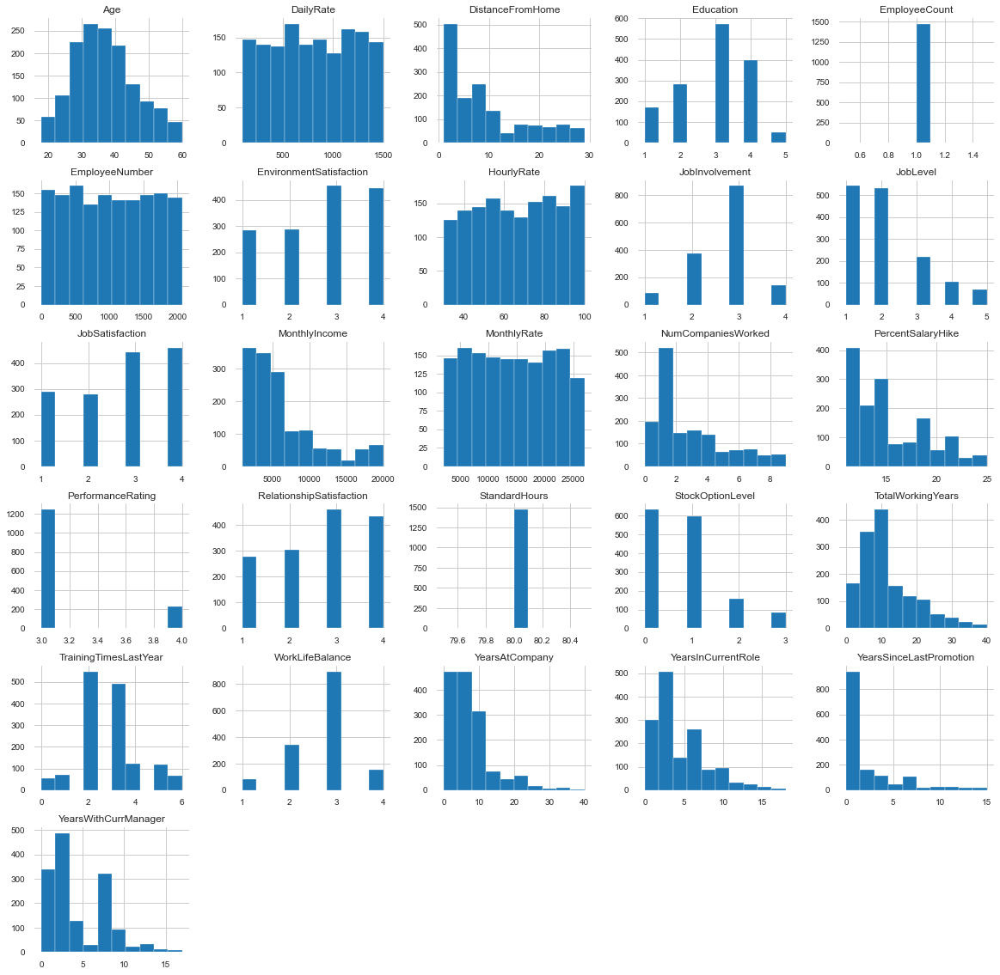

In [30]:
# display the histogram for  numerical variable 
df.hist(figsize=(20,20))
plt.show()


<p> The observation of the histogram shows that, DistanceFromHome, MonthlyIncome,  
NumCompaniesWorked, PercentSalaryHike, TotalWorkingYears ,YearsAtCompany, YearsInCurrentRole, YearsSinceLastPromotion, YearsWithCurrManager are skewed to the right. We can check the presence of outliers in  for those  vraibale </p>

#### Range of values 

In [31]:
df_range = df.select_dtypes(include=['int64'])
rang = df_range.agg(['min', 'max'])
rang= rang.transpose()
print(rang)

                           min    max
Age                         18     60
DailyRate                  102   1499
DistanceFromHome             1     29
Education                    1      5
EmployeeCount                1      1
EmployeeNumber               1   2068
EnvironmentSatisfaction      1      4
HourlyRate                  30    100
JobInvolvement               1      4
JobLevel                     1      5
JobSatisfaction              1      4
MonthlyIncome             1009  19999
MonthlyRate               2094  26999
NumCompaniesWorked           0      9
PercentSalaryHike           11     25
PerformanceRating            3      4
RelationshipSatisfaction     1      4
StandardHours               80     80
StockOptionLevel             0      3
TotalWorkingYears            0     40
TrainingTimesLastYear        0      6
WorkLifeBalance              1      4
YearsAtCompany               0     40
YearsInCurrentRole           0     18
YearsSinceLastPromotion      0     15
YearsWithCur

#### data cleaning and  visualization 

<p> The dataaet does not have a missing variaable </p> 

In [32]:
# check for duplicate variable 

In [33]:
df["Attrition"] = [1 if x == "Yes" else 0 for x in df["Attrition"]]

In [34]:
# take a look on the response variable 
df['Attrition'].value_counts()/1470


0    0.838776
1    0.161224
Name: Attrition, dtype: float64

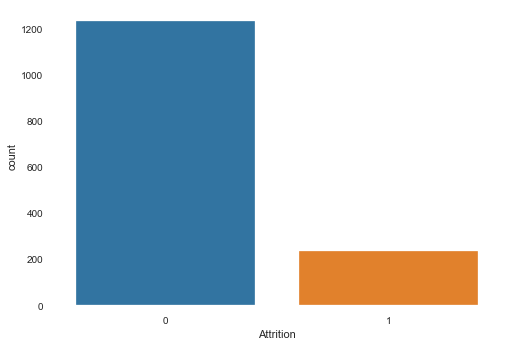

In [35]:
sns.countplot(x='Attrition',data= df)
plt.show()

**We have imballanced data set. we need to  look at close the issiue**

Text(0.5, 1.0, 'Attrition repatition by Gender')

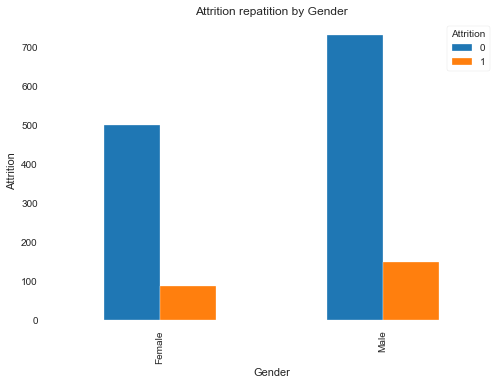

In [36]:
# the repartition of Attrition by gender 
Ct= pd.crosstab(df['Gender'], df['Attrition'])
Ct.plot.bar(stacked=False)
plt.xlabel('Gender')
plt.ylabel('Attrition')
plt.title('Attrition repatition by Gender')

**<font color='teal'> The male's attrition level is greater than women's attrition </font>**

Text(0.5, 1.0, 'Attrition repatition by JobRole')

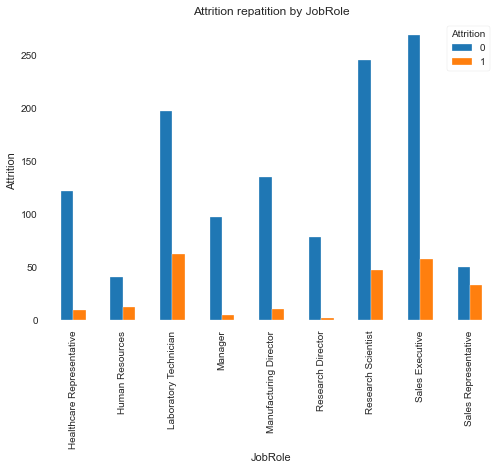

In [37]:
CT= pd.crosstab(df['JobRole'], df['Attrition'])
CT.plot.bar(stacked=False)
plt.xlabel('JobRole')
plt.ylabel('Attrition')
plt.title('Attrition repatition by JobRole')

Text(0.5, 1.0, 'Attrition repatition by JobRole')

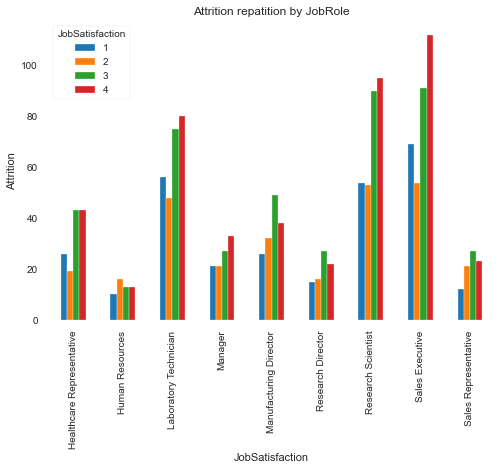

In [38]:
JobS= pd.crosstab(df.JobRole, df.JobSatisfaction)
JobS.plot.bar(stacked=False)
plt.xlabel('JobSatisfaction')
plt.ylabel('Attrition')
plt.title('Attrition repatition by JobRole')

**<font color='teal'> There are more unsatisfied workers among laboratry technicien and  sales ecexutive</font>**

Text(0.5, 1.0, 'Attrition repatition by BusinessTravel')

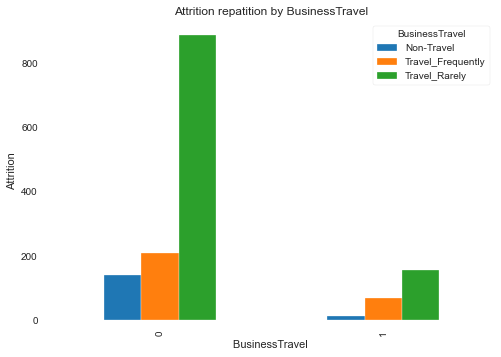

In [39]:
JobTravel= pd.crosstab(df.Attrition, df.BusinessTravel)
JobTravel.plot.bar(stacked=False)
plt.xlabel('BusinessTravel ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by BusinessTravel')

Text(0.5, 1.0, 'Attrition repatition by Department')

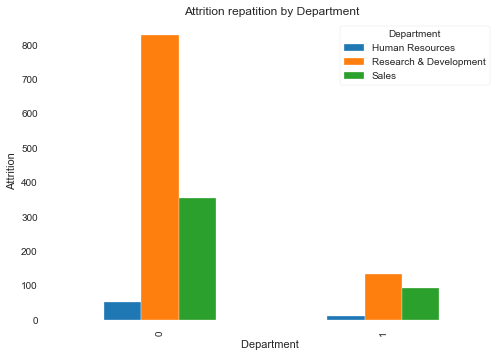

In [40]:
JobTravel= pd.crosstab(df.Attrition, df.Department)
JobTravel.plot.bar(stacked=False)
plt.xlabel('Department ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by Department')

### Features Egineering 
In this step, base on the domain knowledge,  we will creates meaningful features by combining, substracting or squaring existing features. That will improve the performance of the algorithms thet we will choose to traint he model. 

**One of the causes of employee attrition is the lack of opportunity for growth and development. We will create a new feature called grothw_advanced and training.**

In [41]:
def growthAdvanced(data) :
    if data['TrainingTimesLastYear'] <= 3 and data['TrainingTimesLastYear'] <= 6:
        return 0
    else:
        return 1
df['growthAdvanced']= df.apply(lambda data:growthAdvanced(data), axis =1)

 **We combine  the variables  EnvironementSatisfaction, JobSatisfactionand RelationshipSatisfaction JobInvolment and workLifeBalance to create TotalSatisfaction_mean  Variable.**

In [42]:
# total Satisfaction  variable 

df['TotalSatisfaction_mean'] = (df['RelationshipSatisfaction']  + 
                                  df['EnvironmentSatisfaction'] + df['JobSatisfaction'] 
                                  + df['JobInvolvement'] + df['WorkLifeBalance'])/5

**We create a variable NotSatisf  for TotalSatisfaction  inferior to 2.35**

In [43]:
# NotSatisfy  vaiable 
def NotSatisf(data) : 
    if  data['TotalSatisfaction_mean'] < 2.35 :
        return 0
    else : 
        return 1
df['NotSatisf'] = df.apply(lambda data: NotSatisf(data) ,axis = 1)

 **We combine StockOptionLevel and  JobSatisfaction  to creat Inclusion Variable We suppose  an employee is inclused in the company  when  he have a stockOption and satisfy** 

In [44]:
df['Inclusion']= (df['JobSatisfaction']+ df['StockOptionLevel'])/2

**The employee is not incluse enough the inclusion variable is less than 2** 

In [45]:
def NotInclude(data): 
    if  data['Inclusion']< 2 :
        return 0
    else : 
        return 1
df['NotInclude'] = df.apply(lambda data:NotInclude(data),axis = 1)

**Create the variable engage  when the employee over 35 and not single**

In [46]:
def Engaged(data) : 
    if data['Age'] > 35 and data['MaritalStatus'] != 'Single':
        return 1
    else : 
        return 0
df['Engaged'] = df.apply(lambda data:Engaged(data) ,axis = 1)


**Create a variable YoungBadPaid for the Employee between 23 and  35 and montly Income lower than 3500**

In [47]:
def YoungAndBadPaid(data): 
    if data['Age'] < 35 and data['Age'] > 23 and (data['MonthlyIncome'] < 3500):
        return 1
    else : 
        return 0
df['YoungAndBadPaid'] = df.apply(lambda data:YoungAndBadPaid(data) ,axis = 1)

**The stressfulEnv is when the  employee  does overtime, 
travail for business and  not single**  

In [48]:
def StressfulEnV(data): 
    if data['OverTime ']== 'YES' and data['Business travel ']== 'Travel_Frequently'  and data['MaritalStatus'] != 'Single':
        return 1
    else : 
        return 0
df['StressfullEnV'] = df.apply(lambda data:YoungAndBadPaid(data) ,axis = 1)

<p> Create the variable Lack_promotion when  YearIncurentRole is greater than 6 
and  YearSinceLastPromotion  less than 6   </p>

In [49]:
def lack_promotion(data): 
    if data['YearsInCurrentRole'] >= 6 and data['YearsSinceLastPromotion']<=6:
        return 1
    else : 
        return 0
df['lack_promotion'] = df.apply(lambda data:lack_promotion(data) ,axis = 1)

Text(0.5, 1.0, 'Attrition repatition by growthAdvanced')

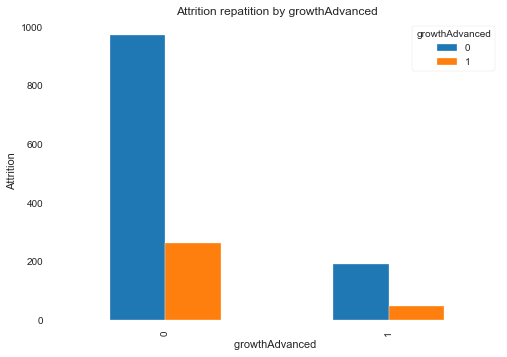

In [50]:
growthAdvanced= pd.crosstab(df.Attrition, df.growthAdvanced)
growthAdvanced.plot.bar(stacked=False)
plt.xlabel('growthAdvanced ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by growthAdvanced')

<p> The attrition of the employee who do not have traning and 

Text(0.5, 1.0, 'Attrition repatition by TotalSatisfaction')

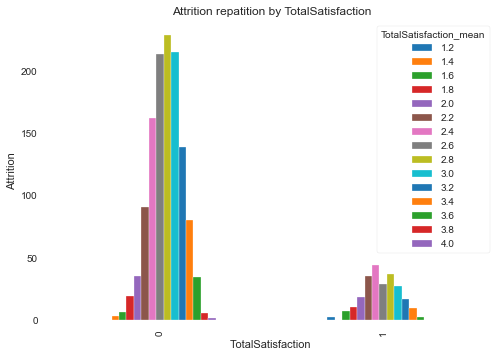

In [51]:
TotalSatisfaction_mean= pd.crosstab(df.Attrition, df.TotalSatisfaction_mean)
TotalSatisfaction_mean.plot.bar(stacked=False)
plt.xlabel('TotalSatisfaction ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by TotalSatisfaction')

In [52]:
df['NotSatisf']

0       0
1       1
2       1
3       1
4       1
       ..
1465    1
1466    0
1467    1
1468    1
1469    1
Name: NotSatisf, Length: 1470, dtype: int64

Text(0.5, 1.0, 'Attrition repatition by NotSatisf')

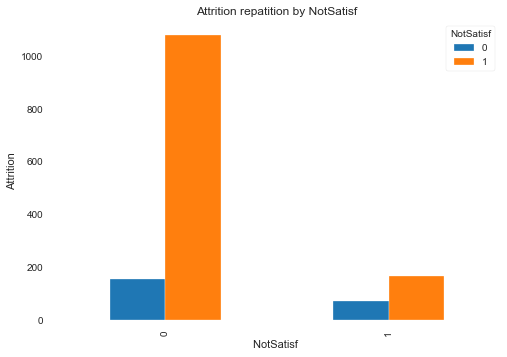

In [53]:
NotSatisf= pd.crosstab(df.Attrition, df.NotSatisf)
NotSatisf.plot.bar(stacked=False)
plt.xlabel('NotSatisf ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by NotSatisf')

Text(0.5, 1.0, 'Attrition repatition by NotInclude')

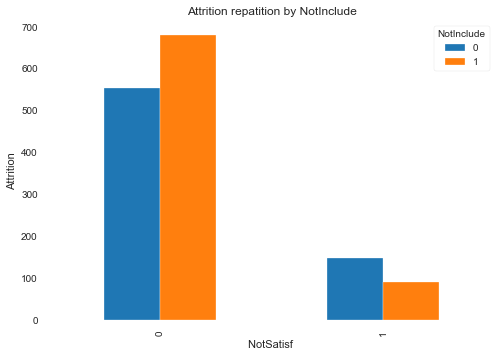

In [54]:
NotInclude= pd.crosstab(df.Attrition, df.NotInclude)
NotInclude.plot.bar(stacked= False)
plt.xlabel('NotSatisf ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by NotInclude')

Text(0.5, 1.0, 'Attrition repatition by lack_promotion')

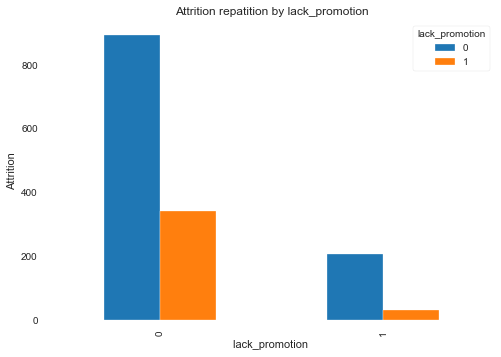

In [55]:
Lack_promotion= pd.crosstab(df.Attrition, df['lack_promotion'])
Lack_promotion.plot.bar(stacked= False)
plt.xlabel('lack_promotion ')
plt.ylabel('Attrition')
plt.title('Attrition repatition by lack_promotion')

In [56]:
df.shape

(1470, 44)

In [57]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,YearsWithCurrManager,growthAdvanced,TotalSatisfaction_mean,NotSatisf,Inclusion,NotInclude,Engaged,YoungAndBadPaid,StressfullEnV,lack_promotion
0,41,1,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,5,0,2.2,0,2.0,1,0,0,0,0
1,49,0,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,7,0,2.8,1,1.5,0,1,0,0,1
2,37,1,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,0,0,2.8,1,1.5,0,0,0,0,0
3,33,0,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,0,0,3.2,1,1.5,0,0,1,1,1
4,27,0,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,2,0,2.6,1,1.5,0,0,1,1,0


### Check  the outliers 

In [58]:
def diagnostic_plot(dataset, variable):
    
    plt.figure(figsize=(16,4))
    
    #histogram
    plt.subplot(1,3,1)
    sns.distplot(df[variable], bins=30)
    plt.title("Histogram")
    
    # Q-Q plot 
    plt.subplot(1 ,3,2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('RM quantiles')
    
    # boxplot
    plt.subplot(1,3,3)
    sns.boxplot(y= df[variable])
    plt.title(' Boxplot')
    
    plt.show()
    

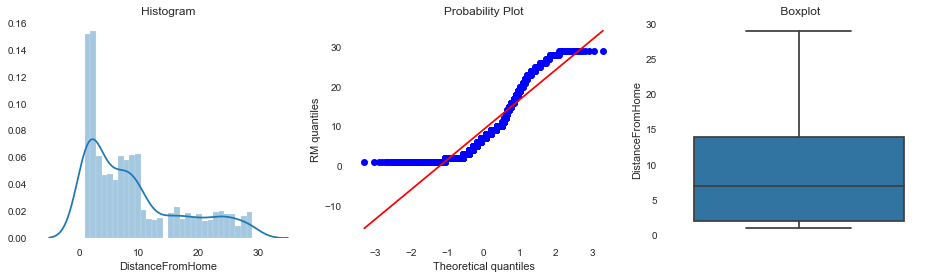

In [59]:
diagnostic_plot(df,'DistanceFromHome')

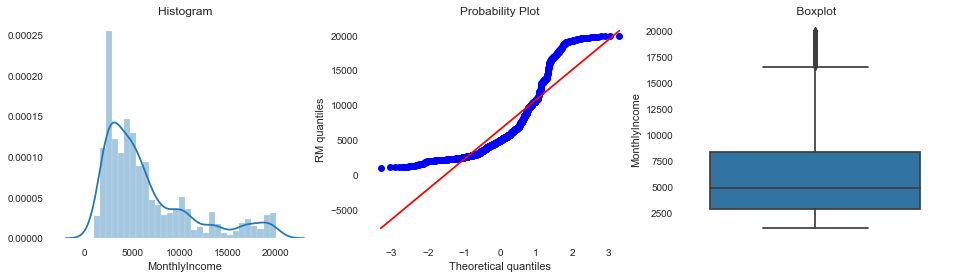

In [60]:
diagnostic_plot(df, 'MonthlyIncome')

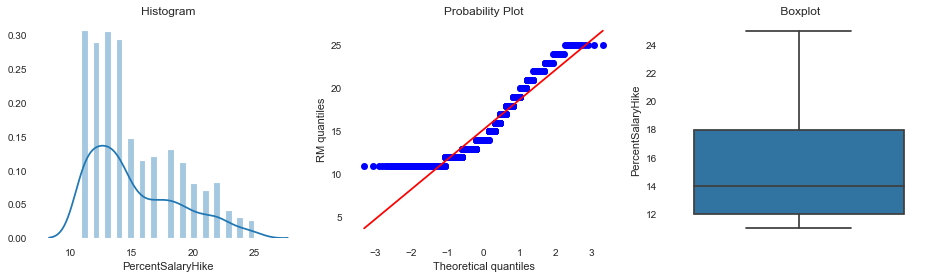

In [61]:
diagnostic_plot(df,'PercentSalaryHike')

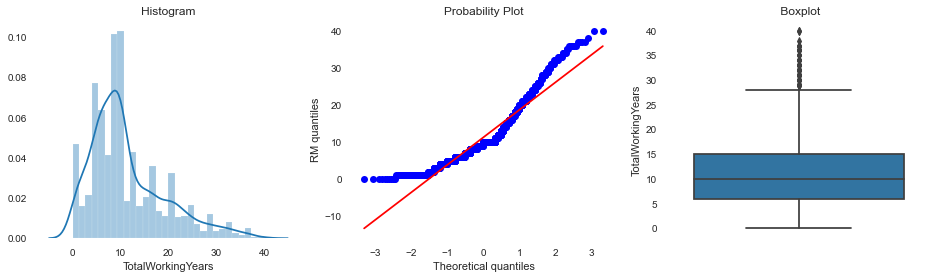

In [62]:
 diagnostic_plot(df,'TotalWorkingYears')

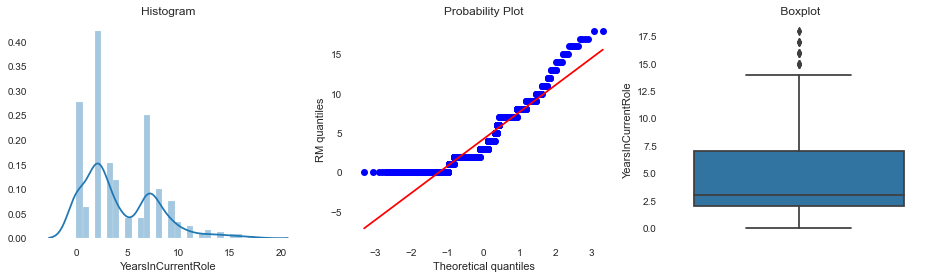

In [63]:
 diagnostic_plot(df,'YearsInCurrentRole' )

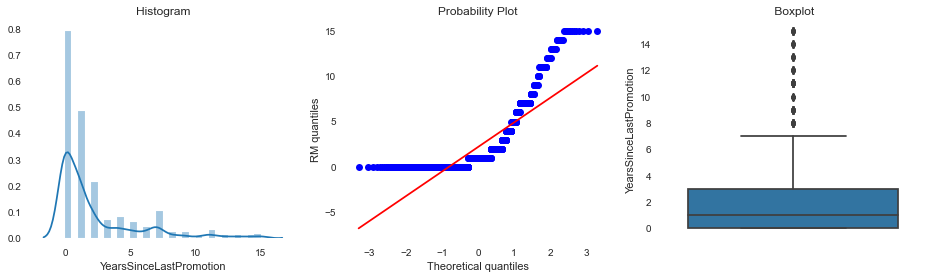

In [64]:
 diagnostic_plot(df, 'YearsSinceLastPromotion' )

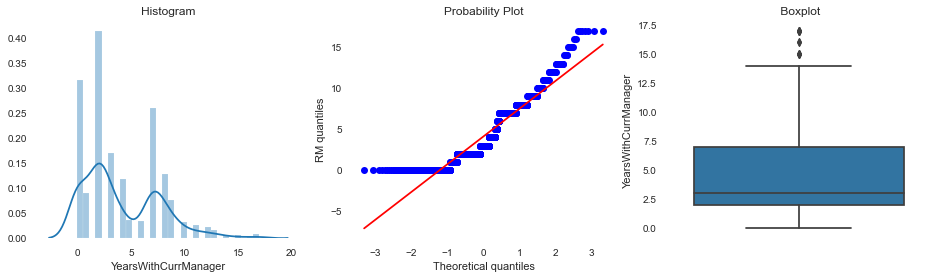

In [65]:
 diagnostic_plot(df, 'YearsWithCurrManager' )

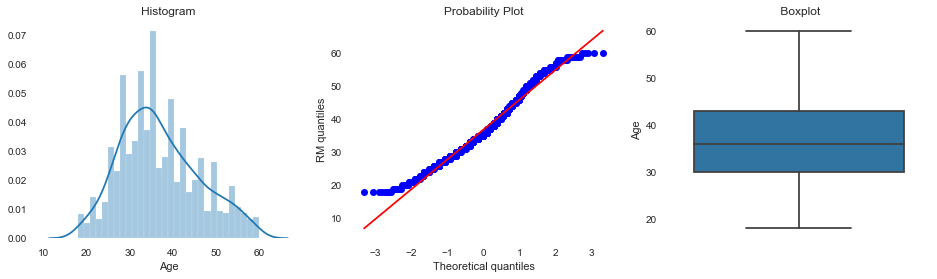

In [66]:
 diagnostic_plot(df, 'Age')

**<font color='teal'> These boxplot show the presence of outliers for the following variable MontlyIcome, YearsIncurrentRole, TotalworkingYears, YearssincelastPromotion , YearsWithcurrManager.</font>**

In [67]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,YearsWithCurrManager,growthAdvanced,TotalSatisfaction_mean,NotSatisf,Inclusion,NotInclude,Engaged,YoungAndBadPaid,StressfullEnV,lack_promotion
0,41,1,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,5,0,2.2,0,2.0,1,0,0,0,0
1,49,0,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,7,0,2.8,1,1.5,0,1,0,0,1
2,37,1,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,0,0,2.8,1,1.5,0,0,0,0,0
3,33,0,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,0,0,3.2,1,1.5,0,0,1,1,1
4,27,0,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,2,0,2.6,1,1.5,0,0,1,1,0


### Create a dummies variable for the categorical features 

In [68]:
# Create a list categorical features and assign to a list called: todummy_list
todummy_list= ['BusinessTravel','Department','EducationField',
                  'Gender','JobRole','MaritalStatus','Over18','OverTime']

In [69]:
df = pd.concat([df.drop(todummy_list, axis=1), pd.get_dummies(df[todummy_list])], axis=1)

In [70]:
df.shape

(1470, 65)

In [71]:
df.columns

Index(['Age', 'Attrition', 'DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeCount', 'EmployeeNumber', 'EnvironmentSatisfaction',
       'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction',
       'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StandardHours', 'StockOptionLevel', 'TotalWorkingYears',
       'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany',
       'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager',
       'growthAdvanced', 'TotalSatisfaction_mean', 'NotSatisf', 'Inclusion',
       'NotInclude', 'Engaged', 'YoungAndBadPaid', 'StressfullEnV',
       'lack_promotion', 'BusinessTravel_Non-Travel',
       'BusinessTravel_Travel_Frequently', 'BusinessTravel_Travel_Rarely',
       'Department_Human Resources', 'Department_Research & Development',
       'Department_Sales', 'EducationField_Human Resources',
       'EducationField_Life

In [72]:
# The reset the index  of the dataframe 
df.reset_index(inplace=True, drop=True)

In [73]:
# Check the first five rows 
df.head()

,Age,Attrition,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,41,1,1102,1,2,1,1,2,94,3,...,0,0,1,0,0,0,1,1,0,1
1,49,0,279,8,1,1,2,3,61,2,...,0,1,0,0,0,1,0,1,1,0
2,37,1,1373,2,2,1,4,4,92,2,...,0,0,0,0,0,0,1,1,0,1
3,33,0,1392,3,4,1,5,4,56,3,...,0,1,0,0,0,1,0,1,0,1
4,27,0,591,2,1,1,7,1,40,3,...,0,0,0,0,0,1,0,1,1,0


In [74]:
# Remove constant features in the dataframe 

**<font color='teal'> Constant features are the type of features that contain only one value for all the outputs in the dataset. Constant features provide no information that can help in classification of the record at hand. </font>**

In [75]:
Constant_features = [feat for feat in df.columns if df[feat].std()==0]
Constant_features

['EmployeeCount', 'StandardHours', 'Over18_Y']

**<font color='teal'> The value of StandardHours and employeeCount  are respectively   80 and 1 for all the outputs. So we will remove them fron the dataframe </font>**

In [76]:
df.drop ( ['EmployeeCount', 'StandardHours'], axis= 1 , inplace= True )

In [77]:
df.shape

(1470, 63)

#### Find correlated features 

In [78]:
def correlation ( dataset, threshold):
    col_corr= set() # set of all the names of correlated columns 
    corr_matrix = dataset.corr()
    for i in range (len(corr_matrix .columns)):
        for j in range (i):
            if abs( corr_matrix.iloc[i, j]) > threshold: # we are interested in absoluhtes coefficient of correlation 
                colname= corr_matrix .columns [i] # getting the name of column 
                col_corr.add(colname)
    return col_corr

In [79]:
corr_features= correlation (df, 0.8)
len(set(corr_features))

9

In [80]:
corr_features

{'Department_Sales',
 'Gender_Male',
 'JobRole_Human Resources',
 'JobRole_Sales Executive',
 'MonthlyIncome',
 'NotInclude',
 'OverTime_Yes',
 'StressfullEnV',
 'growthAdvanced'}

**<font color='teal'> We will remove Department_Sales, JobRole_Human Resources','OverTime_Yes'   feature from the dataset </font>**

In [81]:
# drop correlated features
df.drop(['Department_Sales', 'JobRole_Human Resources','OverTime_Yes'],axis=1,inplace= True )

#### Split the data  into train and test set 

In [82]:

X_train,X_test, y_train, y_test=train_test_split(df.drop(["Attrition"] , axis =1),  df.Attrition, test_size=0.3, random_state=0)
X_train.shape, X_test.shape

((1029, 59), (441, 59))

In [83]:
# let's check the variables that share the same information 
from sklearn.feature_selection import mutual_info_classif
from  sklearn.feature_selection import SelectKBest, SelectPercentile 

In [84]:
# Calculate the mutual information between the varaibles and the target 
# this returns  the mutual information value of each  feature
# the smaller the value the less information the feature has about the target
MI = mutual_info_classif( X_train, y_train)
MI

array([0.03035896, 0.01188252, 0.        , 0.        , 0.        ,
       0.00302089, 0.01041012, 0.02113064, 0.02953169, 0.01204323,
       0.029657  , 0.01156559, 0.02430654, 0.01283646, 0.01545105,
       0.        , 0.02179692, 0.02429783, 0.01781672, 0.        ,
       0.04460693, 0.01322677, 0.02204382, 0.01150221, 0.00070164,
       0.        , 0.0164362 , 0.02256261, 0.01408318, 0.01065052,
       0.00909537, 0.02172932, 0.0006536 , 0.01434564, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.00483806,
       0.        , 0.        , 0.        , 0.        , 0.01574011,
       0.0170962 , 0.        , 0.01257377, 0.01973976, 0.        ,
       0.00046505, 0.01115692, 0.01265415, 0.00935465, 0.        ,
       0.00231639, 0.02739992, 0.00178931, 0.03217432])

In [85]:
# let's have a series for clear visualization
MI = pd.Series(MI)
MI.index= X_train.columns
MI.sort_values(ascending=False )

YearsAtCompany                       0.044607
OverTime_No                          0.032174
Age                                  0.030359
MonthlyIncome                        0.029657
JobLevel                             0.029532
MaritalStatus_Single                 0.027400
NumCompaniesWorked                   0.024307
TotalWorkingYears                    0.024298
Inclusion                            0.022563
YearsSinceLastPromotion              0.022044
StockOptionLevel                     0.021797
StressfullEnV                        0.021729
JobInvolvement                       0.021131
JobRole_Manager                      0.019740
TrainingTimesLastYear                0.017817
Gender_Male                          0.017096
NotSatisf                            0.016436
Gender_Female                        0.015740
PerformanceRating                    0.015451
BusinessTravel_Non-Travel            0.014346
NotInclude                           0.014083
YearsInCurrentRole                

 #### we can see that there a few features( left of the plot ) that seems to contribute the most to predict the target

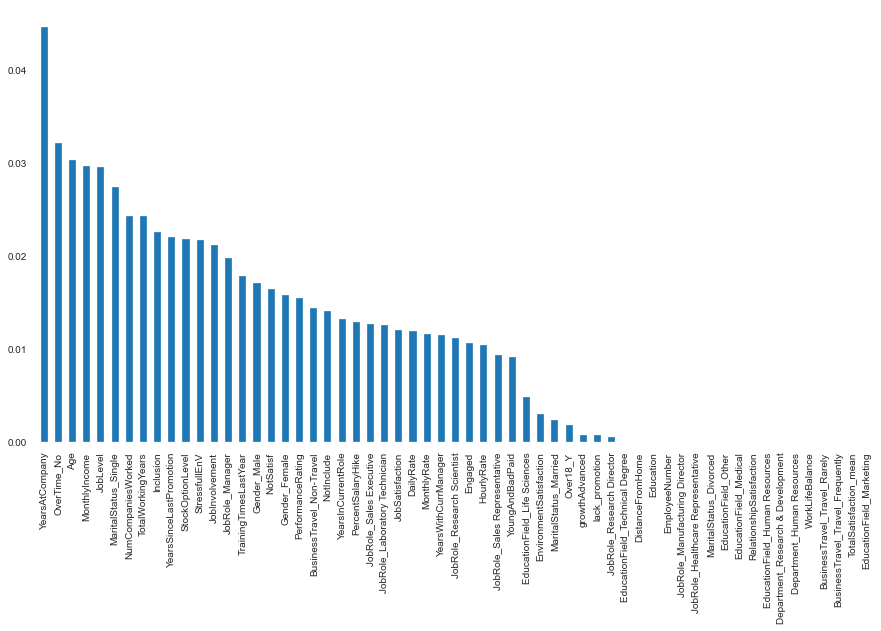

In [86]:
# and now  let's plot  the ordered Mi values per feature
MI.sort_values (ascending=False).plot.bar(figsize= (15, 8))
printmd(" #### we can see that there a few features( left of the plot ) that seems to contribute the most to predict the target")

In [87]:
# here I will select  the top 20 features 
# which  are shown below 
sel_= SelectKBest(mutual_info_classif, k=20).fit(X_train, y_train)
X_train.columns[sel_.get_support()]

Index(['Age', 'MonthlyIncome', 'MonthlyRate', 'TotalWorkingYears',
       'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsInCurrentRole',
       'YearsWithCurrManager', 'TotalSatisfaction_mean', 'NotSatisf',
       'Engaged', 'YoungAndBadPaid', 'BusinessTravel_Travel_Rarely',
       'EducationField_Medical', 'Gender_Female',
       'JobRole_Healthcare Representative', 'JobRole_Research Director',
       'JobRole_Sales Representative', 'Over18_Y', 'OverTime_No'],
      dtype='object')

In [88]:
selected_features= list(X_train.columns[sel_.get_support()])

In [89]:
selected_features.append('Attrition')

In [90]:
len(selected_features)

21

In [91]:
features =list(df.columns)
features

['Age',
 'Attrition',
 'DailyRate',
 'DistanceFromHome',
 'Education',
 'EmployeeNumber',
 'EnvironmentSatisfaction',
 'HourlyRate',
 'JobInvolvement',
 'JobLevel',
 'JobSatisfaction',
 'MonthlyIncome',
 'MonthlyRate',
 'NumCompaniesWorked',
 'PercentSalaryHike',
 'PerformanceRating',
 'RelationshipSatisfaction',
 'StockOptionLevel',
 'TotalWorkingYears',
 'TrainingTimesLastYear',
 'WorkLifeBalance',
 'YearsAtCompany',
 'YearsInCurrentRole',
 'YearsSinceLastPromotion',
 'YearsWithCurrManager',
 'growthAdvanced',
 'TotalSatisfaction_mean',
 'NotSatisf',
 'Inclusion',
 'NotInclude',
 'Engaged',
 'YoungAndBadPaid',
 'StressfullEnV',
 'lack_promotion',
 'BusinessTravel_Non-Travel',
 'BusinessTravel_Travel_Frequently',
 'BusinessTravel_Travel_Rarely',
 'Department_Human Resources',
 'Department_Research & Development',
 'EducationField_Human Resources',
 'EducationField_Life Sciences',
 'EducationField_Marketing',
 'EducationField_Medical',
 'EducationField_Other',
 'EducationField_Technica

In [92]:
features_to_drop = [feature for feature in features if feature not in selected_features]

In [93]:
df.drop(features_to_drop,axis=1 , inplace=True)

In [94]:
X_train,X_test, y_train, y_test=train_test_split(df.drop(["Attrition"] , axis =1),  df.Attrition, test_size=0.3, random_state=0)
X_train.shape, X_test.shape

((1029, 20), (441, 20))

In [95]:
X_train.head()

,Age,MonthlyIncome,MonthlyRate,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsInCurrentRole,YearsWithCurrManager,TotalSatisfaction_mean,NotSatisf,Engaged,YoungAndBadPaid,BusinessTravel_Travel_Rarely,EducationField_Medical,Gender_Female,JobRole_Healthcare Representative,JobRole_Research Director,JobRole_Sales Representative,Over18_Y,OverTime_No
338,30,6118,5431,10,2,3,9,2,3.0,1,0,0,1,0,1,0,0,0,1,1
363,33,2851,9150,1,2,3,0,0,3.0,1,0,1,1,0,1,0,0,1,1,0
759,45,2177,8318,6,3,3,3,4,2.2,0,0,0,1,1,0,0,0,0,1,1
793,28,2207,22482,4,5,2,2,2,2.6,1,0,1,1,0,0,0,0,0,1,1
581,30,3833,24375,7,2,3,2,2,2.8,1,0,0,1,0,0,0,0,0,1,1


### Modeling 

#### The first algorithm:  Xgboost 


In [96]:
from xgboost import XGBClassifier

In [97]:
xgb = XGBClassifier()

In [98]:
xgb.fit( X_train, y_train)

XGBClassifier()

In [99]:
from sklearn.metrics import confusion_matrix,f1_score
y_pred = xgb.predict(X_test)
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[358  13]
 [ 52  18]]


In [100]:
#the classification report 
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.87      0.96      0.92       371
           1       0.58      0.26      0.36        70

    accuracy                           0.85       441
   macro avg       0.73      0.61      0.64       441
weighted avg       0.83      0.85      0.83       441



In [101]:
# The accuracy score 
print(' rf Accuracy:{}'.format(xgb.score(X_test, y_test).round(2)))
      

 rf Accuracy:0.85


 #### Tunning the  model hyperparameters  with RandomizedSearchCv
 
 Let's tune the algoritm hyperparameters to check if we can improve the model's performance 

In [102]:
# define in the param_grid the different hyperparameter that we w

params_grid= { "learning_rate": [ 0.05, 0.1 , 0.15, 0.2, 0.25, 0.30], 
          "max_depth" : [3, 4, 5, 6, 7,8,10, 12, 15 ],
          "min_child_weight" :[ 1,3,5,7],
          "gamma": [0.0, 0.1, 0.2, 0.3, 0,4],
          "colsample_bytree": [ 0.3, 0.4, 0.5, 0.7]}

In [103]:
from sklearn.model_selection import RandomizedSearchCV

In [104]:
random_search = RandomizedSearchCV(xgb, param_distributions=params_grid , n_iter= 5,
                                   scoring= 'roc_auc', n_jobs=-1, cv=5, verbose=3)

In [105]:
# Now we can fit the model the train  
random_search.fit(X_train , y_train)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    2.3s finished


RandomizedSearchCV(cv=5, estimator=XGBClassifier(), n_iter=5, n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.3, 0.4, 0.5,
                                                             0.7],
                                        'gamma': [0.0, 0.1, 0.2, 0.3, 0, 4],
                                        'learning_rate': [0.05, 0.1, 0.15, 0.2,
                                                          0.25, 0.3],
                                        'max_depth': [3, 4, 5, 6, 7, 8, 10, 12,
                                                      15],
                                        'min_child_weight': [1, 3, 5, 7]},
                   scoring='roc_auc', verbose=3)

In [106]:
random_search.best_estimator_

XGBClassifier(colsample_bytree=0.4, gamma=4, learning_rate=0.25, max_depth=8,
              min_child_weight=7)

In [107]:
random_search.best_params_

{'min_child_weight': 7,
 'max_depth': 8,
 'learning_rate': 0.25,
 'gamma': 4,
 'colsample_bytree': 0.4}

In [108]:
# Now we built our algorith with  right  hyperparameter 
Classifier = XGBClassifier(colsample_bytree=0.3, gamma=4, learning_rate=0.05, max_depth=5,
              min_child_weight=7 )

In [109]:
Classifier.fit(X_train, y_train)

XGBClassifier(colsample_bytree=0.3, gamma=4, learning_rate=0.05, max_depth=5,
              min_child_weight=7)

In [110]:
from sklearn.metrics import confusion_matrix,f1_score
y_pred = Classifier.predict(X_test)
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[365   6]
 [ 56  14]]


In [111]:
#the classification report 
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.87      0.98      0.92       371
           1       0.70      0.20      0.31        70

    accuracy                           0.86       441
   macro avg       0.78      0.59      0.62       441
weighted avg       0.84      0.86      0.82       441



#### Tuning results 
**The  tuning  did not bring substantial change to the model , the accuracy still 86% the the recall increase by 0.01** 

###  Solve   imballanced data set issue
There are different ways we could solve imballanced dataset problem 
    1. We can collect more data
    2. Change the performance metrics 
    3. Try different algorithms 
    4. Resample the dataset 
          1 Undersampling
           2 Oversampling 
    5. Generate Synthetic samples 

**In this case study we will resample the data set using the oversample method to generate 
more attrition observations  and look for different algorithms**.   

### Over samplimg method 

In [112]:
import imblearn; imblearn.show_versions(github=True)
from imblearn.over_sampling import RandomOverSampler
ros = RandomOverSampler(random_state=0)
X_resampled, y_resampled = ros.fit_resample(X_train, y_train)
from collections import Counter
print(sorted(Counter(y_resampled).items()))


<details><summary>System, Dependency Information</summary>

**System Information**

* python    : `3.7.6 (default, Jan  8 2020, 13:42:34)  [Clang 4.0.1 (tags/RELEASE_401/final)]`
* executable: `/opt/anaconda3/bin/python`
* machine   : `Darwin-17.7.0-x86_64-i386-64bit`

**Python Dependencies**

* pip       : `20.0.2`
* setuptools: `46.0.0.post20200309`
* imblearn  : `0.7.0`
* sklearn   : `0.23.2`
* numpy     : `1.18.1`
* scipy     : `1.4.1`
* Cython    : `0.29.15`
* pandas    : `1.1.4`
* keras     : `None`
* tensorflow: `None`
* joblib    : `0.14.1`

</details>
[(0, 862), (1, 862)]


###  Use Different algorithms  

In [113]:
from sklearn.ensemble  import  RandomForestClassifier 
from sklearn.ensemble  import VotingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC

In [114]:
# create an object for the different algorithms 
log_clf  = LogisticRegression()
rnd_clf =RandomForestClassifier()
svm_clf= SVC()
adb_clf= AdaBoostClassifier()

In [115]:
Voting_clf = VotingClassifier(
    estimators =[('lr', log_clf), ('rf', rnd_clf), ('svc', svm_clf), ('ad', adb_clf)], voting= 'hard')
Voting_clf.fit (X_train, y_train)

VotingClassifier(estimators=[('lr', LogisticRegression()),
                             ('rf', RandomForestClassifier()), ('svc', SVC()),
                             ('ad', AdaBoostClassifier())])

In [116]:
# let's look  at each classifier's accuracy on the test set 
from sklearn.metrics import accuracy_score
for clf in (log_clf,rnd_clf ,adb_clf,svm_clf, Voting_clf):
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    print(clf.__class__.__name__, accuracy_score(y_test, y_pred).round(2))

LogisticRegression 0.84
RandomForestClassifier 0.85
AdaBoostClassifier 0.84
SVC 0.84
VotingClassifier 0.84


In [117]:
# tyning the logistic regression's hyperparameter 
from sklearn.model_selection import GridSearchCV

# Setup the hyperparameter grid
c_space = np.logspace(-5, 8, 15)
param_grid = {'C': c_space}

# Instantiate a logistic regression classifier: logreg
logreg = LogisticRegression()

# Instantiate the GridSearchCV object: logreg_cv

logreg_cv = GridSearchCV(logreg, param_grid, cv=5)

# Fit it to the data
logreg_cv.fit(X_train , y_train )

GridSearchCV(cv=5, estimator=LogisticRegression(),
             param_grid={'C': array([1.00000000e-05, 8.48342898e-05, 7.19685673e-04, 6.10540230e-03,
       5.17947468e-02, 4.39397056e-01, 3.72759372e+00, 3.16227766e+01,
       2.68269580e+02, 2.27584593e+03, 1.93069773e+04, 1.63789371e+05,
       1.38949549e+06, 1.17876863e+07, 1.00000000e+08])})

In [118]:
# predict 
y_pred= logreg_cv.predict(X_test)

In [119]:
accuracy_score(y_test, y_pred)

0.8412698412698413

### Conclusions 

**Model accauracy**

The accuarcy of the ensemble method( Xgboost , Randomforest and  adaboost) is 86% while 
Logistic regression and SVM  have respectively  85% and 84%.

**The fifteen(15) best predictions , that is varaible variable with high correlation with the lablel are the followings** 
  1. Age
  2. HourlyRate
  3. JobLevel
  4. MonthlyIncome
  5. NumCompaniesWorked
  6. YearsAtCompany
  7. YearsInCurrentRole
  8. YearsWithCurrManager
  9. TotalSatisfaction_mean
  10. YoungAndBadPaid
  11. BusinessTravel_Non-Travel

#### FINAL RECOMMANDATIONS 

**1. First Recommendation**

The analysis shows that remuneration (HourlyRate, MonthlyIncome, JobLevel) is one of the leading drivers of employee attrition. We recommend a salary survey to find the optimal salary range in the industries of the company. Managers could do that through the collection of external data on the internet. Also, it is essential to include in the exit interview questions about the remuneration. Those actions will allow the company to implement a competitive remuneration package that will attract and retain employees. 

**2 Second Recommmandation**
The age histogram shows that 50% of the employees are under 40 years. The company needs to create an innovative environment and focus on employee mentor relationships to connect the younger and old employees. That will increases job satisfaction and business growth.

**Third Recommendations** 

The remaining variables are related to the position's nature (YearsAtCompanies, YearsInCurrent Role, YearsWithCurrManager Total SatisFaction mean. Top Managers need to review the internal process through a comprehensive job description and evaluation to allow more growth opportunities for the younger generation.  This way, employees will not stay long in the same position. 












